# Exploratory Data Analysis - 1st Edition

### - Setup the notebook and read in the data

In [1]:
# common imports
import requests
import time
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import seaborn as sns

In [2]:
pd.show_versions()

/opt/anaconda3/envs/py39/lib/python3.9/site-packages/_distutils_hack/__init__.py:33: UserWarning: Setuptools is replacing distutils.
  warnings.warn("Setuptools is replacing distutils.")



INSTALLED VERSIONS
------------------
commit           : 2cb96529396d93b46abab7bbc73a208e708c642e
python           : 3.9.13.final.0
python-bits      : 64
OS               : Darwin
OS-release       : 18.7.0
Version          : Darwin Kernel Version 18.7.0: Tue Jun 22 19:37:08 PDT 2021; root:xnu-4903.278.70~1/RELEASE_X86_64
machine          : x86_64
processor        : i386
byteorder        : little
LC_ALL           : en_US.UTF-8
LANG             : en_US.UTF-8
LOCALE           : en_US.UTF-8

pandas           : 1.2.4
numpy            : 1.16.6
pytz             : 2022.1
dateutil         : 2.8.2
pip              : 22.2.2
setuptools       : 65.5.0
Cython           : None
pytest           : 7.1.2
hypothesis       : 6.29.3
sphinx           : None
blosc            : None
feather          : None
xlsxwriter       : None
lxml.etree       : 4.9.1
html5lib         : 1.1
pymysql          : None
psycopg2         : 2.8.6 (dt dec pq3 ext lo64)
jinja2           : 3.1.2
IPython          : 8.4.0
pandas_datar

In [3]:
# Importing data from csv file
path = "/Users/mirror/Desktop/GitHub/nfl_game_predictor/data/scraped_data.csv"
df = pd.read_csv(path)

In [4]:
df

,season,team,week,day,date,time,result,ot,record,home_team,...,rushyd,to,1st_downs_allowed,totyd_allowed,passyd_allowed,rushyd_allowed,to_forced,off_exp_pts,def_exp_pts,sts_exp_pts
0,2022,BUF,1,Thu,September 8,8:20PM ET,W,NaN,1-0,@,...,121.0,4.0,19.0,243.0,191.0,52.0,3.0,13.89,10.29,-3.96
1,2022,BUF,2,Mon,September 19,7:15PM ET,W,NaN,2-0,NaN,...,101.0,NaN,12.0,187.0,107.0,80.0,4.0,17.69,18.01,1.55
2,2022,BUF,3,Sun,September 25,1:00PM ET,L,NaN,2-1,@,...,115.0,1.0,15.0,212.0,171.0,41.0,NaN,15.88,-7.45,-4.86
3,2022,BUF,4,Sun,October 2,1:00PM ET,W,NaN,3-1,@,...,125.0,2.0,22.0,296.0,134.0,162.0,2.0,2.10,2.66,-1.69
4,2022,BUF,5,Sun,October 9,1:00PM ET,W,NaN,4-1,NaN,...,120.0,2.0,23.0,364.0,310.0,54.0,2.0,20.66,9.42,3.54
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14993,1994,LAR,13,Sun,November 27,4:00PM ET,L,NaN,4-8,@,...,48.0,5.0,16.0,243.0,129.0,114.0,1.0,-15.08,12.27,-6.03
14994,1994,LAR,14,Sun,December 4,4:00PM ET,L,NaN,4-9,NaN,...,75.0,4.0,20.0,328.0,191.0,137.0,1.0,-1.17,-3.52,-13.22
14995,1994,LAR,15,Sun,December 11,1:00PM ET,L,NaN,4-10,@,...,63.0,2.0,17.0,355.0,230.0,125.0,NaN,-11.84,-12.38,5.25
14996,1994,LAR,16,Sun,December 18,1:00PM ET,L,NaN,4-11,@,...,37.0,1.0,19.0,298.0,135.0,163.0,NaN,-1.42,-6.17,-8.99


### - Initial exploration of the dataset

In [5]:
df.shape

(14998, 26)

In [6]:
df.dtypes

season                 int64
team                  object
week                  object
day                   object
date                  object
time                  object
result                object
ot                    object
record                object
home_team             object
opp                   object
points_scored        float64
points_allowed       float64
1st_downs            float64
totyd                float64
passyd               float64
rushyd               float64
to                   float64
1st_downs_allowed    float64
totyd_allowed        float64
passyd_allowed       float64
rushyd_allowed       float64
to_forced            float64
off_exp_pts          float64
def_exp_pts          float64
sts_exp_pts          float64
dtype: object

In [7]:
df.describe()

,season,points_scored,points_allowed,1st_downs,totyd,passyd,rushyd,to,1st_downs_allowed,totyd_allowed,passyd_allowed,rushyd_allowed,to_forced,off_exp_pts,def_exp_pts,sts_exp_pts
count,14998.000000,14998.000000,14998.000000,14998.000000,14998.000000,14996.000000,14998.000000,11711.000000,14998.000000,14998.000000,14996.000000,14998.000000,11711.000000,14998.000000,14998.000000,1.499800e+04
mean,2007.949060,21.872583,21.872583,19.215029,333.507934,220.516604,113.020736,2.105542,19.215029,333.515869,220.524607,113.020669,2.105542,-0.094729,0.095483,-6.839886e-18
std,8.171729,10.242435,10.242435,5.024031,84.742442,77.300944,51.170579,1.199685,5.024031,84.739260,77.299476,51.170837,1.199685,12.643270,12.643795,5.514566e+00
min,1994.000000,0.000000,0.000000,2.000000,26.000000,-19.000000,-18.000000,1.000000,2.000000,26.000000,-19.000000,-18.000000,1.000000,-56.000000,-46.750000,-2.851000e+01
25%,2001.000000,14.000000,14.000000,16.000000,275.000000,166.000000,76.000000,1.000000,16.000000,275.000000,166.000000,76.000000,1.000000,-8.497500,-8.520000,-3.470000e+00
50%,2008.000000,21.000000,21.000000,19.000000,333.000000,216.000000,106.000000,2.000000,19.000000,333.000000,216.000000,106.000000,2.000000,0.200000,-0.200000,0.000000e+00
75%,2015.000000,28.000000,28.000000,23.000000,390.000000,270.000000,143.000000,3.000000,23.000000,390.000000,270.000000,143.000000,3.000000,8.527500,8.497500,3.470000e+00
max,2022.000000,62.000000,62.000000,40.000000,653.000000,522.000000,407.000000,8.000000,40.000000,653.000000,522.000000,407.000000,8.000000,46.750000,56.000000,2.851000e+01


In [8]:
df.corr()

,season,points_scored,points_allowed,1st_downs,totyd,passyd,rushyd,to,1st_downs_allowed,totyd_allowed,passyd_allowed,rushyd_allowed,to_forced,off_exp_pts,def_exp_pts,sts_exp_pts
season,1.000000e+00,0.086517,0.086517,0.145438,0.142101,0.138446,0.026067,-0.132830,0.145438,0.142190,0.138540,0.026067,-0.132830,0.206480,-0.206404,-1.110985e-15
points_scored,8.651728e-02,1.000000,-0.036693,0.565062,0.627325,0.428696,0.390609,-0.249967,0.044729,0.038754,0.203341,-0.242551,0.281599,0.747671,0.119250,-5.445609e-02
points_allowed,8.651728e-02,-0.036693,1.000000,0.044729,0.038756,0.203337,-0.242546,0.281599,0.565062,0.627313,0.428668,0.390602,-0.249967,-0.119270,-0.747656,5.445609e-02
1st_downs,1.454377e-01,0.565062,0.044729,1.000000,0.810884,0.635764,0.381524,-0.066918,-0.098900,-0.052930,0.081199,-0.210158,-0.060181,0.682850,-0.118355,-2.882328e-01
totyd,1.421012e-01,0.627325,0.038756,0.810884,1.000000,0.804230,0.440303,-0.076079,-0.052935,-0.001963,0.134506,-0.206457,-0.024998,0.722302,-0.088955,-3.153458e-01
passyd,1.384459e-01,0.428696,0.203337,0.635764,0.804230,1.000000,-0.179343,0.013571,0.081187,0.134531,0.182984,-0.054634,-0.101161,0.522057,-0.222030,-2.466968e-01
rushyd,2.606668e-02,0.390609,-0.242546,0.381524,0.440303,-0.179343,1.000000,-0.150576,-0.210155,-0.206500,-0.054673,-0.257776,0.108854,0.406540,0.187775,-1.485275e-01
to,-1.328303e-01,-0.249967,0.281599,-0.066918,-0.076079,0.013571,-0.150576,1.000000,-0.060181,-0.024970,-0.101131,0.108855,-0.064985,-0.456317,0.007171,1.492968e-03
1st_downs_allowed,1.454377e-01,0.044729,0.565062,-0.098900,-0.052935,0.081187,-0.210155,-0.060181,1.000000,0.810902,0.635762,0.381522,-0.066918,0.118329,-0.682853,2.882328e-01
totyd_allowed,1.421902e-01,0.038754,0.627313,-0.052930,-0.001963,0.134531,-0.206500,-0.024970,0.810902,1.000000,0.804215,0.440284,-0.076087,0.088959,-0.722299,3.153239e-01


In [9]:
df.isnull().sum()

season                   0
team                     0
week                     0
day                      0
date                     0
time                     0
result                   0
ot                   14076
record                   0
home_team             7471
opp                      0
points_scored            0
points_allowed           0
1st_downs                0
totyd                    0
passyd                   2
rushyd                   0
to                    3287
1st_downs_allowed        0
totyd_allowed            0
passyd_allowed           2
rushyd_allowed           0
to_forced             3287
off_exp_pts              0
def_exp_pts              0
sts_exp_pts              0
dtype: int64

### - Initial data cleansing

In [10]:
# discovering how many times an opponent played a game
df.opp.value_counts()

New England Patriots        506
Green Bay Packers           498
Pittsburgh Steelers         493
Indianapolis Colts          489
Philadelphia Eagles         486
Seattle Seahawks            485
San Francisco 49ers         484
Denver Broncos              480
Kansas City Chiefs          478
Minnesota Vikings           477
Dallas Cowboys              477
New Orleans Saints          476
Atlanta Falcons             475
Tampa Bay Buccaneers        474
New York Giants             474
New York Jets               471
Miami Dolphins              470
Arizona Cardinals           469
Buffalo Bills               468
Cincinnati Bengals          468
Chicago Bears               468
Detroit Lions               463
Carolina Panthers           458
Jacksonville Jaguars        455
Baltimore Ravens            452
Washington Redskins         423
Cleveland Browns            414
Oakland Raiders             408
Tennessee Titans            394
San Diego Chargers          382
St. Louis Rams              346
Houston 

In [11]:
# dropping bye week rows, playoff rows, etc.
df = df[df['result'].notna()]

In [12]:
# there are only supposed to be 32 teams in the NFL. some teams have changed their name and/or location.
len(df.opp.unique())

40

In [13]:
#opp_dict = {"Washington Commanders":["Washington Redskins", "Washington Football Team"], 
#            "Las Vegas Raiders":"Oakland Raiders", "Los Angeles Chargers":"San Diego Chargers", 
#            "Tennessee Titans":["Tennessee Oilers", "Houston Oilers"], "Los Angeles Rams":"St. Louis Rams"}

In [14]:
# some teams have changed their name and/or location, which created another opponent.
# manually replacing team names.
df.loc[df["opp"] == "Washington Redskins", "opp"] = "Washington Commanders"
df.loc[df["opp"] == "Washington Football Team", "opp"] = "Washington Commanders"
df.loc[df["opp"] == "Oakland Raiders", "opp"] = "Las Vegas Raiders"
df.loc[df["opp"] == "Los Angeles Raiders", "opp"] = "Las Vegas Raiders"
df.loc[df["opp"] == "Houston Oilers", "opp"] = "Tennessee Titans"
df.loc[df["opp"] == "Tennessee Oilers", "opp"] = "Tennessee Titans"
df.loc[df["opp"] == "San Diego Chargers", "opp"] = "Los Angeles Chargers"
df.loc[df["opp"] == "St. Louis Rams", "opp"] = "Los Angeles Rams"

In [15]:
# verifying that there are only 32 teams in the df.opp column now.
len(df.opp.unique())

32

### Converting Missing Values and Categorical Data Types

In [16]:
# convert misc values for columns "home/away" (home team?) and "ot" (overtime) to a binary integer
df.loc[df["home_team"] == "@", "home_team"] = 0
df.loc[df["home_team"] == "N", "home_team"] = 0
df.loc[df["ot"] == "OT", "ot"] = 1

In [17]:
# convert NaN values for columns "home/away" (home team?) to the integer 1.
df['home_team'] = df['home_team'].fillna(1)

In [18]:
# convert NaN values for columns "ot" (overtime), "to" (turnovers), and "to_forced" to the integer 0.
df['ot'] = df['ot'].fillna(0)
df['to'] = df['to'].fillna(0)
df['to_forced'] = df['to_forced'].fillna(0)

In [19]:
# dropping unnecessary rows such as rows indicating when playoffs start or for games not played yet. 
df = df[df['week'].notna()]

###### Duplicated line of code possibly??? #######

In [20]:
# convert playoff games to follow week numbers (wildcard = 19, divisional = 20, and so on...)
# but remember - before 2021, teams only played 17 week seasons, so wildcard would be = to 18 for these years. 
# For the seasons of 2021 and beyond, teams play an 18 week season
#df.loc[(df['week'] == 'Wild Card') & (df['season'] == 2021), df.['week'] = 19
#df['week'] = np.where(df.week.str.contains('Wild Card') & df.season == 2021, 19, df.week) #not working
#q = []
#count = 0
#for i in df['week']:
#    if i == 'Wild Card':
#        while df['season'] == 2021:
#            q.append(19)
#        else:
#            q.append(18)
#    else:
#        q.append(i)
#    else:
#        if i == 'Wild Card':
#            q.append(18)
#        else:
#            q.append(i)  
#q
#df = df.assign(week = q)

In [21]:
# convert playoff games to follow week numbers (wildcard = 19, divisional = 20, and so on... for seasons 2021).
# but remember - before 2021, teams only played 17 week regular seasons, so wildcard would be = to 18 for these years. 
# For the seasons of 2021 and beyond, teams play an 18 week season.
w = []
y = df.loc[df['season'] == 2021]
for i in y['week']:
    if i == 'Wild Card':
        w.append(19)
    elif i == 'Division':
        w.append(20)
    elif i == 'Conf. Champ.':
        w.append(21)
    elif i == 'SuperBowl':
        w.append(23)
    else:
        w.append(int(i))

dfy = df.loc[df['season'] == 2021].assign(week = w)
dfy

,season,team,week,day,date,time,result,ot,record,home_team,...,rushyd,to,1st_downs_allowed,totyd_allowed,passyd_allowed,rushyd_allowed,to_forced,off_exp_pts,def_exp_pts,sts_exp_pts
246,2021,BUF,1,Sun,September 12,1:00PM ET,L,0,0-1,1,...,117.0,1.0,16.0,252.0,177.0,75.0,0.0,-3.55,0.54,-5.01
247,2021,BUF,2,Sun,September 19,1:00PM ET,W,0,1-1,0,...,143.0,2.0,13.0,216.0,145.0,71.0,3.0,8.16,24.67,-0.37
248,2021,BUF,3,Sun,September 26,1:00PM ET,W,0,2-1,1,...,122.0,0.0,13.0,290.0,212.0,78.0,3.0,20.55,8.27,-7.29
249,2021,BUF,4,Sun,October 3,1:00PM ET,W,0,3-1,1,...,199.0,1.0,6.0,109.0,61.0,48.0,5.0,14.54,32.68,-6.40
250,2021,BUF,5,Sun,October 10,8:20PM ET,W,0,4-1,0,...,121.0,0.0,29.0,392.0,272.0,120.0,4.0,19.84,1.20,-1.50
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
811,2021,SEA,14,Sun,December 12,1:00PM ET,W,0,5-8,0,...,193.0,0.0,25.0,380.0,317.0,63.0,0.0,21.71,2.60,-9.75
812,2021,SEA,15,Tue,December 21,7:00PM ET,L,0,5-9,0,...,80.0,1.0,20.0,332.0,209.0,123.0,1.0,-8.13,-4.19,3.72
813,2021,SEA,16,Sun,December 26,4:05PM ET,L,0,5-10,1,...,170.0,0.0,26.0,317.0,229.0,88.0,0.0,8.31,-7.60,-3.95
814,2021,SEA,17,Sun,January 2,4:25PM ET,W,0,6-10,1,...,265.0,0.0,20.0,357.0,262.0,95.0,3.0,32.32,-3.55,-2.68


In [22]:
# convert playoff games to follow week numbers (wildcard = 19, divisional = 20, and so on... for seasons 2021).
# but remember - before 2021, teams only played 17 week regular seasons, so wildcard would be = to 18 for these years. 
# For the seasons of 2021 and beyond, teams play an 18 week season.
e = []
r = df.loc[df['season'] != 2021]
for i in r['week']:
    if i == 'Wild Card':
        e.append(18)
    elif i == 'Division':
        e.append(19)
    elif i == 'Conf. Champ.':
        e.append(20)
    elif i == 'SuperBowl':
        e.append(22)
    else:
        e.append(int(i))

dfe = df.loc[df['season'] != 2021].assign(week = e)
dfe

,season,team,week,day,date,time,result,ot,record,home_team,...,rushyd,to,1st_downs_allowed,totyd_allowed,passyd_allowed,rushyd_allowed,to_forced,off_exp_pts,def_exp_pts,sts_exp_pts
0,2022,BUF,1,Thu,September 8,8:20PM ET,W,0,1-0,0,...,121.0,4.0,19.0,243.0,191.0,52.0,3.0,13.89,10.29,-3.96
1,2022,BUF,2,Mon,September 19,7:15PM ET,W,0,2-0,1,...,101.0,0.0,12.0,187.0,107.0,80.0,4.0,17.69,18.01,1.55
2,2022,BUF,3,Sun,September 25,1:00PM ET,L,0,2-1,0,...,115.0,1.0,15.0,212.0,171.0,41.0,0.0,15.88,-7.45,-4.86
3,2022,BUF,4,Sun,October 2,1:00PM ET,W,0,3-1,0,...,125.0,2.0,22.0,296.0,134.0,162.0,2.0,2.10,2.66,-1.69
4,2022,BUF,5,Sun,October 9,1:00PM ET,W,0,4-1,1,...,120.0,2.0,23.0,364.0,310.0,54.0,2.0,20.66,9.42,3.54
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14993,1994,LAR,13,Sun,November 27,4:00PM ET,L,0,4-8,0,...,48.0,5.0,16.0,243.0,129.0,114.0,1.0,-15.08,12.27,-6.03
14994,1994,LAR,14,Sun,December 4,4:00PM ET,L,0,4-9,1,...,75.0,4.0,20.0,328.0,191.0,137.0,1.0,-1.17,-3.52,-13.22
14995,1994,LAR,15,Sun,December 11,1:00PM ET,L,0,4-10,0,...,63.0,2.0,17.0,355.0,230.0,125.0,0.0,-11.84,-12.38,5.25
14996,1994,LAR,16,Sun,December 18,1:00PM ET,L,0,4-11,0,...,37.0,1.0,19.0,298.0,135.0,163.0,0.0,-1.42,-6.17,-8.99


In [23]:
# combining the dataframes back together and sorting based on index.
df = pd.concat([dfy, dfe])
df = df.sort_index()

In [24]:
df.head(500)

,season,team,week,day,date,time,result,ot,record,home_team,...,rushyd,to,1st_downs_allowed,totyd_allowed,passyd_allowed,rushyd_allowed,to_forced,off_exp_pts,def_exp_pts,sts_exp_pts
0,2022,BUF,1,Thu,September 8,8:20PM ET,W,0,1-0,0,...,121.0,4.0,19.0,243.0,191.0,52.0,3.0,13.89,10.29,-3.96
1,2022,BUF,2,Mon,September 19,7:15PM ET,W,0,2-0,1,...,101.0,0.0,12.0,187.0,107.0,80.0,4.0,17.69,18.01,1.55
2,2022,BUF,3,Sun,September 25,1:00PM ET,L,0,2-1,0,...,115.0,1.0,15.0,212.0,171.0,41.0,0.0,15.88,-7.45,-4.86
3,2022,BUF,4,Sun,October 2,1:00PM ET,W,0,3-1,0,...,125.0,2.0,22.0,296.0,134.0,162.0,2.0,2.10,2.66,-1.69
4,2022,BUF,5,Sun,October 9,1:00PM ET,W,0,4-1,1,...,120.0,2.0,23.0,364.0,310.0,54.0,2.0,20.66,9.42,3.54
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,2021,LV,18,Sun,January 9,8:25PM ET,W,1,10-7,1,...,174.0,0.0,27.0,440.0,355.0,85.0,2.0,11.13,-16.16,8.69
496,2021,LV,19,Sat,January 15,4:30PM ET,L,0,10-8,0,...,103.0,2.0,18.0,308.0,225.0,83.0,0.0,3.65,-7.92,-1.81
497,2021,LAC,1,Sun,September 12,1:00PM ET,W,0,1-0,0,...,90.0,2.0,15.0,259.0,133.0,126.0,1.0,9.45,-1.45,-1.24
498,2021,LAC,2,Sun,September 19,4:25PM ET,L,0,1-1,1,...,95.0,2.0,25.0,419.0,221.0,198.0,1.0,5.55,-17.50,-1.81


In [25]:
# game's "result" needs to be converted into an integer
df.loc[df["result"] == "W", "result"] = 1
df.loc[df["result"] == "T", "result"] = 0
df.loc[df["result"] == "L", "result"] = 0

In [26]:
# changing the data types for some of the object columns
df[["result", "home_team"]] = df[["result", "home_team"]].apply(pd.to_numeric)

In [27]:
# checking how many rows still have missing values in them
df[df.isnull().any(axis=1)]

,season,team,week,day,date,time,result,ot,record,home_team,...,rushyd,to,1st_downs_allowed,totyd_allowed,passyd_allowed,rushyd_allowed,to_forced,off_exp_pts,def_exp_pts,sts_exp_pts
6726,2009,NYJ,17,Sun,January 3,8:31PM ET,1,0,9-7,1,...,257.0,0.0,5.0,72.0,NaN,72.0,3.0,10.82,33.61,-6.11
6777,2009,CIN,17,Sun,January 3,8:31PM ET,0,0,10-6,0,...,72.0,3.0,21.0,320.0,63.0,257.0,0.0,-33.61,-10.82,6.11
10148,2003,LV,17,Sun,December 28,4:15PM ET,0,0,4-12,0,...,141.0,1.0,20.0,337.0,74.0,263.0,0.0,-25.91,-1.64,16.75
10164,2003,LAC,17,Sun,December 28,4:15PM ET,1,0,4-12,1,...,263.0,0.0,9.0,141.0,NaN,141.0,1.0,1.64,25.91,-16.75


In [28]:
# verifying the null counts in the df
df.isnull().sum()

season               0
team                 0
week                 0
day                  0
date                 0
time                 0
result               0
ot                   0
record               0
home_team            0
opp                  0
points_scored        0
points_allowed       0
1st_downs            0
totyd                0
passyd               2
rushyd               0
to                   0
1st_downs_allowed    0
totyd_allowed        0
passyd_allowed       2
rushyd_allowed       0
to_forced            0
off_exp_pts          0
def_exp_pts          0
sts_exp_pts          0
dtype: int64

In [29]:
# converting the last four missing values to zero. The net passing yards equaled zero due to sacks.
df['passyd'] = df['passyd'].fillna(0)
df['passyd_allowed'] = df['passyd_allowed'].fillna(0)

In [30]:
# verifying the data types in the df
df.dtypes

season                 int64
team                  object
week                   int64
day                   object
date                  object
time                  object
result                 int64
ot                     int64
record                object
home_team              int64
opp                   object
points_scored        float64
points_allowed       float64
1st_downs            float64
totyd                float64
passyd               float64
rushyd               float64
to                   float64
1st_downs_allowed    float64
totyd_allowed        float64
passyd_allowed       float64
rushyd_allowed       float64
to_forced            float64
off_exp_pts          float64
def_exp_pts          float64
sts_exp_pts          float64
dtype: object

In [31]:
# checking how many rows still have missing values in them
len(df[df.isnull().any(axis=1)])

0

In [32]:
# "day" of the week needs to be converted into an integer.
day_dict = {"Tue":1, "Wed":2, "Thu":3, "Fri":4, "Sat":5, "Sun":6, "Mon":7}

# using the manually created day_dictionary to replace the day of the week.
df = df.replace({"day": day_dict}) 

In [33]:
# date need to be converted into a numerical value (month and day_of_month)
c = []
v = []
for i in df['date']:
    c.append((i.split(' ')[0]))
    v.append(int(i.split(' ')[1]))
df = df.assign(month = c)
df = df.assign(day_of_month = v)

In [34]:
# "month of the year needs to be converted into an integer. NFL games start in August (preseason) and end in February (super bowl).
month_dict = {"January":1, "February":2, "March":3, "April":4, "May":5, "June":6, 
            "July":7, "August":8, "September":9, "October":10, "November":11, "December":12}

# using the manually created day_dictionary to replace the day of the week.
df = df.replace({"month": month_dict}) 

In [35]:
# we can drop the date column after converting it
df = df.drop('date', axis=1)

In [36]:
# time needs to be converted into a numerical value
b = []
for i in df['time']:
    if 'PM' in i:
        b.append(int(i[0]) + 12)
    else:
        b.append(int(i[0]))
df = df.assign(hour = b)

In [37]:
df

,season,team,week,day,time,result,ot,record,home_team,opp,...,totyd_allowed,passyd_allowed,rushyd_allowed,to_forced,off_exp_pts,def_exp_pts,sts_exp_pts,month,day_of_month,hour
0,2022,BUF,1,3,8:20PM ET,1,0,1-0,0,Los Angeles Rams,...,243.0,191.0,52.0,3.0,13.89,10.29,-3.96,9,8,20
1,2022,BUF,2,7,7:15PM ET,1,0,2-0,1,Tennessee Titans,...,187.0,107.0,80.0,4.0,17.69,18.01,1.55,9,19,19
2,2022,BUF,3,6,1:00PM ET,0,0,2-1,0,Miami Dolphins,...,212.0,171.0,41.0,0.0,15.88,-7.45,-4.86,9,25,13
3,2022,BUF,4,6,1:00PM ET,1,0,3-1,0,Baltimore Ravens,...,296.0,134.0,162.0,2.0,2.10,2.66,-1.69,10,2,13
4,2022,BUF,5,6,1:00PM ET,1,0,4-1,1,Pittsburgh Steelers,...,364.0,310.0,54.0,2.0,20.66,9.42,3.54,10,9,13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14993,1994,LAR,13,6,4:00PM ET,0,0,4-8,0,Los Angeles Chargers,...,243.0,129.0,114.0,1.0,-15.08,12.27,-6.03,11,27,16
14994,1994,LAR,14,6,4:00PM ET,0,0,4-9,1,New Orleans Saints,...,328.0,191.0,137.0,1.0,-1.17,-3.52,-13.22,12,4,16
14995,1994,LAR,15,6,1:00PM ET,0,0,4-10,0,Tampa Bay Buccaneers,...,355.0,230.0,125.0,0.0,-11.84,-12.38,5.25,12,11,13
14996,1994,LAR,16,6,1:00PM ET,0,0,4-11,0,Chicago Bears,...,298.0,135.0,163.0,0.0,-1.42,-6.17,-8.99,12,18,13


In [38]:
# we can drop the time column after converting it
df = df.drop('time', axis=1)

In [39]:
# record need to be converted into a numerical value (cumulative wins and cumulative losses)
y = []
z = []
for i in df['record']:
    y.append(int(i.split('-')[0]))
    z.append(int(i.split('-')[1]))
df = df.assign(win_count = y)
df = df.assign(loss_count = z)

# we can drop the record column after converting it
df = df.drop('record', axis=1)

In [40]:
################# verify that these numerical codes correspond to the df["team"] #################
################# then drop the "opp" and "team" columns #################
# converting opponent's team name to a nurmerical category
# we need to verify that the opp_code matches with the team_code. Each team should be labeled with identical opp and team codes.
df["opp_code"] = df["opp"].astype("category").cat.codes
df["team_code"] = df["team"].astype("category").cat.codes

In [41]:
df.loc[df['team'] == 'LAC'].head(50)

,season,team,week,day,result,ot,home_team,opp,points_scored,points_allowed,...,off_exp_pts,def_exp_pts,sts_exp_pts,month,day_of_month,hour,win_count,loss_count,opp_code,team_code
100,2022,LAC,1,6,1,0,1,Las Vegas Raiders,24.0,19.0,...,6.30,2.73,-1.95,9,11,16,1,0,16,16
101,2022,LAC,2,3,0,0,0,Kansas City Chiefs,24.0,27.0,...,4.12,-5.54,-3.72,9,15,20,1,1,15,16
102,2022,LAC,3,6,0,0,1,Jacksonville Jaguars,10.0,38.0,...,-10.35,-18.06,2.60,9,25,16,1,2,14,16
103,2022,LAC,4,6,1,0,0,Houston Texans,34.0,24.0,...,16.95,-3.13,-4.62,10,2,13,2,2,12,16
104,2022,LAC,5,6,1,0,0,Cleveland Browns,30.0,28.0,...,16.01,-16.53,4.92,10,9,13,3,2,7,16
105,2022,LAC,6,7,1,1,1,Denver Broncos,19.0,16.0,...,-1.03,3.11,0.92,10,17,20,4,2,9,16
106,2022,LAC,7,6,0,0,1,Seattle Seahawks,23.0,37.0,...,-4.60,-12.13,1.10,10,23,16,4,3,28,16
497,2021,LAC,1,6,1,0,0,Washington Commanders,20.0,16.0,...,9.45,-1.45,-1.24,9,12,13,1,0,31,16
498,2021,LAC,2,6,0,0,1,Dallas Cowboys,17.0,20.0,...,5.55,-17.50,-1.81,9,19,16,1,1,8,16
499,2021,LAC,3,6,1,0,0,Kansas City Chiefs,30.0,24.0,...,16.65,-9.49,-3.01,9,26,13,2,1,15,16


In [42]:
df.dtypes

season                 int64
team                  object
week                   int64
day                    int64
result                 int64
ot                     int64
home_team              int64
opp                   object
points_scored        float64
points_allowed       float64
1st_downs            float64
totyd                float64
passyd               float64
rushyd               float64
to                   float64
1st_downs_allowed    float64
totyd_allowed        float64
passyd_allowed       float64
rushyd_allowed       float64
to_forced            float64
off_exp_pts          float64
def_exp_pts          float64
sts_exp_pts          float64
month                  int64
day_of_month           int64
hour                   int64
win_count              int64
loss_count             int64
opp_code                int8
team_code               int8
dtype: object

In [43]:
# we can drop the opp and team columns after converting it into numerical codes.
df = df.drop('opp', axis=1)
df = df.drop('team', axis=1)

In [44]:
df

,season,week,day,result,ot,home_team,points_scored,points_allowed,1st_downs,totyd,...,off_exp_pts,def_exp_pts,sts_exp_pts,month,day_of_month,hour,win_count,loss_count,opp_code,team_code
0,2022,1,3,1,0,0,31.0,10.0,23.0,413.0,...,13.89,10.29,-3.96,9,8,20,1,0,18,3
1,2022,2,7,1,0,1,41.0,7.0,23.0,414.0,...,17.69,18.01,1.55,9,19,19,2,0,30,3
2,2022,3,6,0,0,0,19.0,21.0,31.0,497.0,...,15.88,-7.45,-4.86,9,25,13,2,1,19,3
3,2022,4,6,1,0,0,23.0,20.0,22.0,326.0,...,2.10,2.66,-1.69,10,2,13,3,1,2,3
4,2022,5,6,1,0,1,38.0,3.0,21.0,552.0,...,20.66,9.42,3.54,10,9,13,4,1,26,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14993,1994,13,6,0,0,0,17.0,31.0,17.0,326.0,...,-15.08,12.27,-6.03,11,27,16,4,8,17,17
14994,1994,14,6,0,0,1,15.0,31.0,20.0,333.0,...,-1.17,-3.52,-13.22,12,4,16,4,9,22,17
14995,1994,15,6,0,0,0,14.0,24.0,19.0,261.0,...,-11.84,-12.38,5.25,12,11,13,4,10,29,17
14996,1994,16,6,0,0,0,13.0,27.0,13.0,243.0,...,-1.42,-6.17,-8.99,12,18,13,4,11,5,17


In [45]:
# Reordering the columns to my preference
cols = df.columns.tolist()
cols = cols[0:1] + cols[-1:] + cols[1:3] + cols[-7:-1] + cols[3:-7]
df = df[cols]
df

,season,team_code,week,day,month,day_of_month,hour,win_count,loss_count,opp_code,...,rushyd,to,1st_downs_allowed,totyd_allowed,passyd_allowed,rushyd_allowed,to_forced,off_exp_pts,def_exp_pts,sts_exp_pts
0,2022,3,1,3,9,8,20,1,0,18,...,121.0,4.0,19.0,243.0,191.0,52.0,3.0,13.89,10.29,-3.96
1,2022,3,2,7,9,19,19,2,0,30,...,101.0,0.0,12.0,187.0,107.0,80.0,4.0,17.69,18.01,1.55
2,2022,3,3,6,9,25,13,2,1,19,...,115.0,1.0,15.0,212.0,171.0,41.0,0.0,15.88,-7.45,-4.86
3,2022,3,4,6,10,2,13,3,1,2,...,125.0,2.0,22.0,296.0,134.0,162.0,2.0,2.10,2.66,-1.69
4,2022,3,5,6,10,9,13,4,1,26,...,120.0,2.0,23.0,364.0,310.0,54.0,2.0,20.66,9.42,3.54
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14993,1994,17,13,6,11,27,16,4,8,17,...,48.0,5.0,16.0,243.0,129.0,114.0,1.0,-15.08,12.27,-6.03
14994,1994,17,14,6,12,4,16,4,9,22,...,75.0,4.0,20.0,328.0,191.0,137.0,1.0,-1.17,-3.52,-13.22
14995,1994,17,15,6,12,11,13,4,10,29,...,63.0,2.0,17.0,355.0,230.0,125.0,0.0,-11.84,-12.38,5.25
14996,1994,17,16,6,12,18,13,4,11,5,...,37.0,1.0,19.0,298.0,135.0,163.0,0.0,-1.42,-6.17,-8.99


In [54]:
cols

['season',
 'team_code',
 'week',
 'day',
 'month',
 'day_of_month',
 'hour',
 'win_count',
 'loss_count',
 'opp_code',
 'result',
 'ot',
 'home_team',
 'points_scored',
 'points_allowed',
 '1st_downs',
 'totyd',
 'passyd',
 'rushyd',
 'to',
 '1st_downs_allowed',
 'totyd_allowed',
 'passyd_allowed',
 'rushyd_allowed',
 'to_forced',
 'off_exp_pts',
 'def_exp_pts',
 'sts_exp_pts']

## Data Analysis and Data Visualization

In [46]:
df.shape

(14998, 28)

In [47]:
df.describe()

,season,team_code,week,day,month,day_of_month,hour,win_count,loss_count,opp_code,...,rushyd,to,1st_downs_allowed,totyd_allowed,passyd_allowed,rushyd_allowed,to_forced,off_exp_pts,def_exp_pts,sts_exp_pts
count,14998.000000,14998.000000,14998.000000,14998.000000,14998.000000,14998.000000,14998.000000,14998.000000,14998.000000,14998.000000,...,14998.000000,14998.000000,14998.000000,14998.000000,14998.000000,14998.000000,14998.000000,14998.000000,14998.000000,1.499800e+04
mean,2007.949060,15.644886,9.464195,5.912655,9.950660,15.740099,15.049073,4.551674,4.258835,15.646153,...,113.020736,1.644086,19.215029,333.515869,220.495199,113.020669,1.644086,-0.094729,0.095483,-6.839886e-18
std,8.171729,9.249185,5.299978,0.673149,2.572046,8.673648,2.644956,3.415167,3.011117,9.249460,...,51.170579,1.372049,5.024031,84.739260,77.336257,51.170837,1.372049,12.643270,12.643795,5.514566e+00
min,1994.000000,0.000000,1.000000,1.000000,1.000000,1.000000,8.000000,0.000000,0.000000,0.000000,...,-18.000000,0.000000,2.000000,26.000000,-19.000000,-18.000000,0.000000,-56.000000,-46.750000,-2.851000e+01
25%,2001.000000,8.000000,5.000000,6.000000,9.000000,8.000000,13.000000,2.000000,2.000000,8.000000,...,76.000000,1.000000,16.000000,275.000000,166.000000,76.000000,1.000000,-8.497500,-8.520000,-3.470000e+00
50%,2008.000000,16.000000,10.000000,6.000000,10.000000,16.000000,13.000000,4.000000,4.000000,16.000000,...,106.000000,1.000000,19.000000,333.000000,216.000000,106.000000,1.000000,0.200000,-0.200000,0.000000e+00
75%,2015.000000,24.000000,14.000000,6.000000,12.000000,23.000000,16.000000,7.000000,6.000000,24.000000,...,143.000000,2.000000,23.000000,390.000000,270.000000,143.000000,2.000000,8.527500,8.497500,3.470000e+00
max,2022.000000,31.000000,23.000000,7.000000,12.000000,31.000000,21.000000,18.000000,16.000000,31.000000,...,407.000000,8.000000,40.000000,653.000000,522.000000,407.000000,8.000000,46.750000,56.000000,2.851000e+01


In [48]:
df.corr()

,season,team_code,week,day,month,day_of_month,hour,win_count,loss_count,opp_code,...,rushyd,to,1st_downs_allowed,totyd_allowed,passyd_allowed,rushyd_allowed,to_forced,off_exp_pts,def_exp_pts,sts_exp_pts
season,1.000000e+00,-0.016916,-2.928217e-02,-8.493489e-02,-4.614635e-02,2.128703e-02,2.951009e-02,-0.018208,-0.017314,-0.016749,...,0.026067,-0.145730,0.145438,0.142190,0.138553,0.026067,-0.145730,0.206480,-0.206404,-1.110985e-15
team_code,-1.691601e-02,1.000000,9.240577e-03,1.162870e-02,-1.410938e-02,-3.954075e-03,5.424461e-02,0.037084,-0.027743,-0.078059,...,0.028371,-0.018241,-0.021108,-0.023314,-0.000417,-0.037977,0.004794,0.022569,0.025171,-1.663377e-02
week,-2.928217e-02,0.009241,1.000000e+00,-9.849479e-02,-3.762790e-02,5.769453e-02,4.209821e-02,0.793671,0.717233,0.009443,...,0.030578,0.001622,-0.012486,-0.013286,-0.034788,0.030575,0.001622,-0.005297,0.005327,-5.325198e-18
day,-8.493489e-02,0.011629,-9.849479e-02,1.000000e+00,1.761442e-02,-3.145726e-02,-9.616407e-02,-0.082354,-0.067338,0.011346,...,0.000289,0.026911,-0.017633,-0.013904,-0.015426,0.000289,0.026911,-0.029996,0.030003,1.879398e-17
month,-4.614635e-02,-0.014109,-3.762790e-02,1.761442e-02,1.000000e+00,1.691782e-01,-4.030123e-02,-0.168551,0.124932,-0.014552,...,0.015507,-0.002955,-0.022472,-0.020838,-0.033091,0.015504,-0.002955,-0.023713,0.023748,-4.968813e-19
day_of_month,2.128703e-02,-0.003954,5.769453e-02,-3.145726e-02,1.691782e-01,1.000000e+00,-6.880133e-04,0.031029,0.061797,-0.004116,...,-0.002842,-0.001067,0.000911,0.006920,0.009458,-0.002835,-0.001067,0.005594,-0.005614,8.914873e-19
hour,2.951009e-02,0.054245,4.209821e-02,-9.616407e-02,-4.030123e-02,-6.880133e-04,1.000000e+00,0.107959,-0.056208,0.053434,...,-0.013071,-0.016391,0.020562,0.018648,0.029084,-0.013075,-0.016391,0.031197,-0.031176,4.969898e-18
win_count,-1.820767e-02,0.037084,7.936710e-01,-8.235409e-02,-1.685511e-01,3.102920e-02,1.079593e-01,1.000000,0.151000,0.004327,...,0.107857,-0.090521,-0.081332,-0.093508,-0.043966,-0.088403,0.090403,0.167435,0.114834,-2.939213e-02
loss_count,-1.731426e-02,-0.027743,7.172333e-01,-6.733785e-02,1.249317e-01,6.179738e-02,-5.620807e-02,0.151000,1.000000,0.010708,...,-0.073678,0.105468,0.074166,0.086906,-0.005939,0.152893,-0.100686,-0.198855,-0.124626,3.485654e-02
opp_code,-1.674880e-02,-0.078059,9.443218e-03,1.134626e-02,-1.455199e-02,-4.116082e-03,5.343367e-02,0.004327,0.010708,1.000000,...,-0.038526,0.005870,0.007808,0.026183,0.010426,0.027601,-0.018205,-0.026357,-0.024026,1.794779e-02


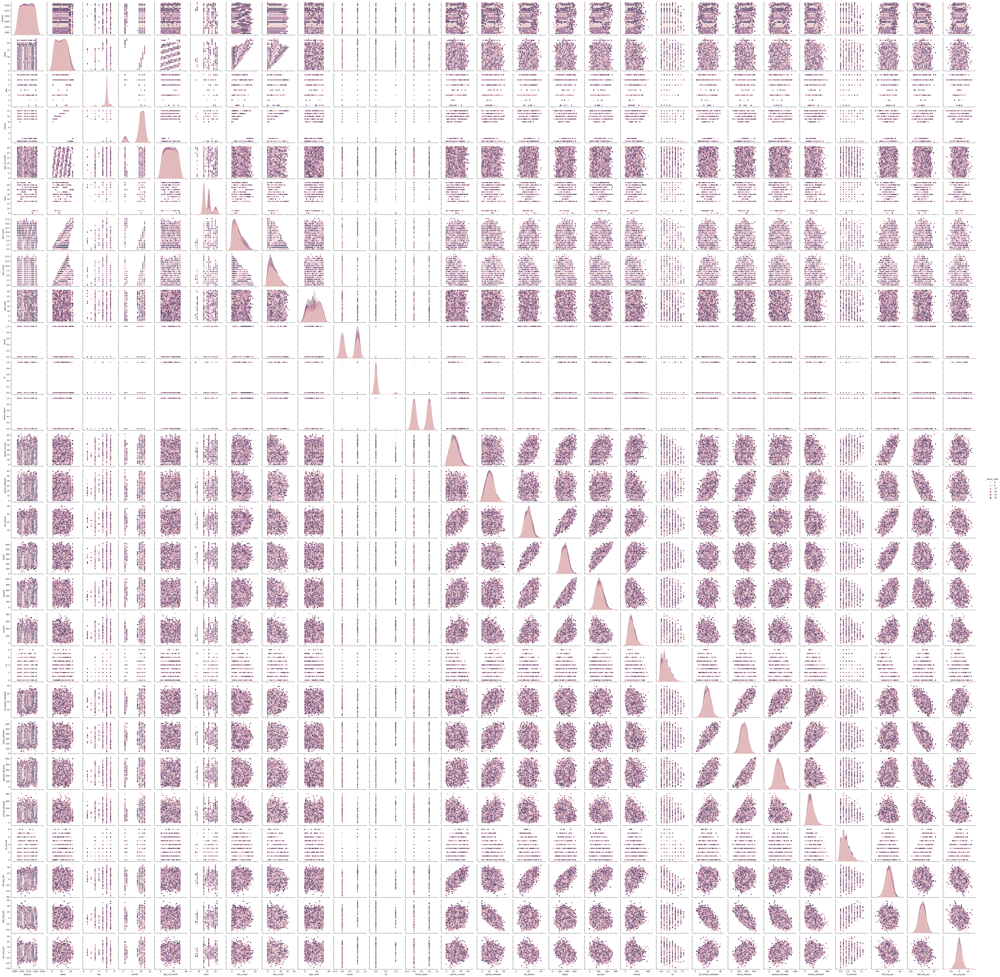

In [49]:
sns.pairplot(df, hue="team_code")

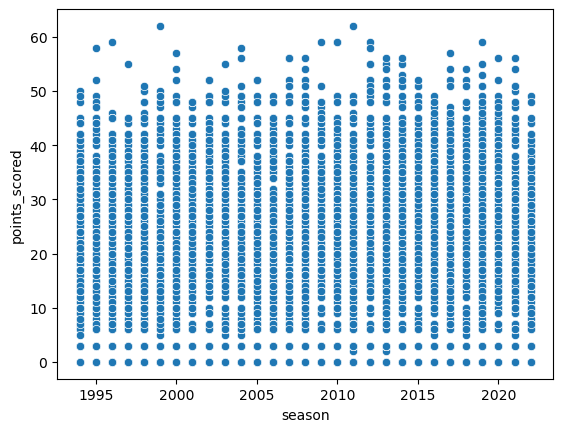

In [50]:
sns.scatterplot(x=df['season'], y=df['points_scored']);

In [51]:
corrs = df.corr()
best_corrs_feats = corrs.index
plt.figure(figsize=(10,10))

<Figure size 1000x1000 with 0 Axes>

<Figure size 1000x1000 with 0 Axes>

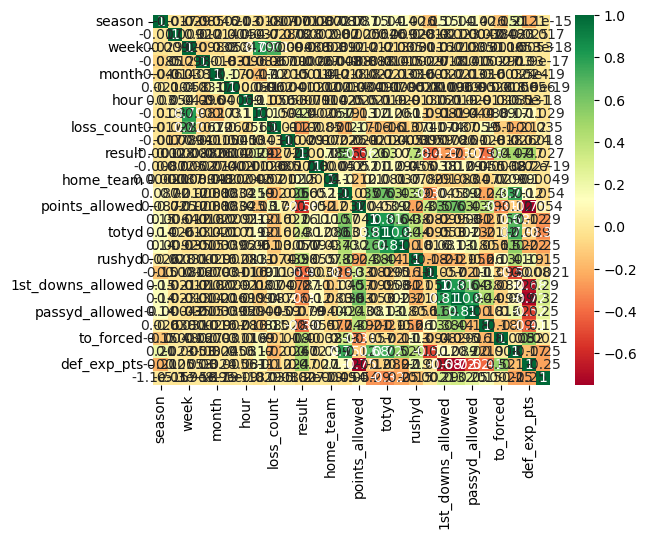

In [52]:
corr_heatmap = sns.heatmap(df[best_corrs_feats].corr(), annot = True, cmap = "RdYlGn")

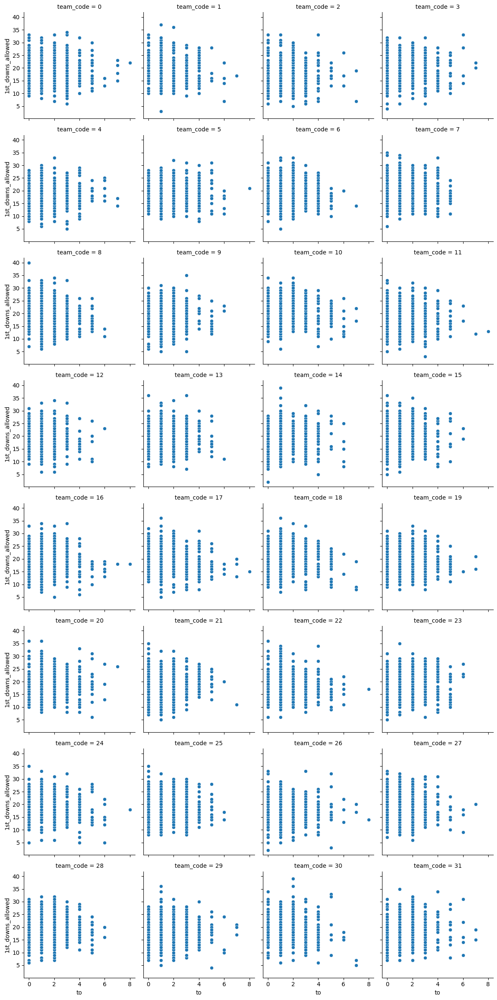

In [53]:
cond_plot = sns.FacetGrid(data=df, col='team_code', hue=None, col_wrap=4)
cond_plot.map(sns.scatterplot, 'to', '1st_downs_allowed');